<a href="https://colab.research.google.com/github/sravyaysk/CS-7641-MachineLearning/blob/main/HW3/Unsupervised_Learning_on_Creditcard_Fraud_dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Introduction

This dataset consists of credit card transactions that occured in Europe on September 2013. 

Dataset link: https://datahub.io/machine-learning/creditcard

Our goal is to take all the features V1,V2,V3 and so on in the dataset and predict whether the transaction is Fraud or Not (Binary Classification problem)

In [ ]:
import numpy as np
import pandas as pd
import time

%matplotlib inline 
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import seaborn as sns
from tqdm.notebook import tqdm
from scipy.linalg import pinv
from numpy import linalg as LA

from sklearn.svm import SVC
from sklearn import metrics
from sklearn.cluster import KMeans
from sklearn.neural_network import MLPClassifier

from sklearn.metrics import classification_report, accuracy_score  
from sklearn.metrics import precision_score, recall_score 
from sklearn.metrics import f1_score, matthews_corrcoef 
from sklearn.metrics import confusion_matrix 
from sklearn.metrics import roc_auc_score
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.metrics import adjusted_mutual_info_score, mean_squared_error
from sklearn.metrics.cluster import homogeneity_score
from sklearn import mixture
from sklearn.mixture import GaussianMixture

from sklearn.model_selection import cross_val_score, train_test_split
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.preprocessing import LabelEncoder

from sklearn.model_selection import validation_curve
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import learning_curve

from sklearn.decomposition import PCA, FastICA
from sklearn.random_projection import GaussianRandomProjection
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

In [ ]:
data = pd.read_csv('./data/creditcard.csv')
data.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


In [ ]:
data.isnull().sum()

Time      0
V1        0
V2        0
V3        0
V4        0
V5        0
V6        0
V7        0
V8        0
V9        0
V10       0
V11       0
V12       0
V13       0
V14       0
V15       0
V16       0
V17       0
V18       0
V19       0
V20       0
V21       0
V22       0
V23       0
V24       0
V25       0
V26       0
V27       0
V28       0
Amount    0
Class     0
dtype: int64

In [ ]:
data.describe()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
count,284807.000000,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,...,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,284807.000000,284807.000000
mean,94813.859575,3.918649e-15,5.682686e-16,-8.761736e-15,2.811118e-15,-1.552103e-15,2.040130e-15,-1.698953e-15,-1.893285e-16,-3.147640e-15,...,1.473120e-16,8.042109e-16,5.282512e-16,4.456271e-15,1.426896e-15,1.701640e-15,-3.662252e-16,-1.217809e-16,88.349619,0.001727
std,47488.145955,1.958696e+00,1.651309e+00,1.516255e+00,1.415869e+00,1.380247e+00,1.332271e+00,1.237094e+00,1.194353e+00,1.098632e+00,...,7.345240e-01,7.257016e-01,6.244603e-01,6.056471e-01,5.212781e-01,4.822270e-01,4.036325e-01,3.300833e-01,250.120109,0.041527
min,0.000000,-5.640751e+01,-7.271573e+01,-4.832559e+01,-5.683171e+00,-1.137433e+02,-2.616051e+01,-4.355724e+01,-7.321672e+01,-1.343407e+01,...,-3.483038e+01,-1.093314e+01,-4.480774e+01,-2.836627e+00,-1.029540e+01,-2.604551e+00,-2.256568e+01,-1.543008e+01,0.000000,0.000000
25%,54201.500000,-9.203734e-01,-5.985499e-01,-8.903648e-01,-8.486401e-01,-6.915971e-01,-7.682956e-01,-5.540759e-01,-2.086297e-01,-6.430976e-01,...,-2.283949e-01,-5.423504e-01,-1.618463e-01,-3.545861e-01,-3.171451e-01,-3.269839e-01,-7.083953e-02,-5.295979e-02,5.600000,0.000000
50%,84692.000000,1.810880e-02,6.548556e-02,1.798463e-01,-1.984653e-02,-5.433583e-02,-2.741871e-01,4.010308e-02,2.235804e-02,-5.142873e-02,...,-2.945017e-02,6.781943e-03,-1.119293e-02,4.097606e-02,1.659350e-02,-5.213911e-02,1.342146e-03,1.124383e-02,22.000000,0.000000
75%,139320.500000,1.315642e+00,8.037239e-01,1.027196e+00,7.433413e-01,6.119264e-01,3.985649e-01,5.704361e-01,3.273459e-01,5.971390e-01,...,1.863772e-01,5.285536e-01,1.476421e-01,4.395266e-01,3.507156e-01,2.409522e-01,9.104512e-02,7.827995e-02,77.165000,0.000000
max,172792.000000,2.454930e+00,2.205773e+01,9.382558e+00,1.687534e+01,3.480167e+01,7.330163e+01,1.205895e+02,2.000721e+01,1.559499e+01,...,2.720284e+01,1.050309e+01,2.252841e+01,4.584549e+00,7.519589e+00,3.517346e+00,3.161220e+01,3.384781e+01,25691.160000,1.000000


In [ ]:
# data preprocessing
data.dropna()
data[data == '?'] = np.NaN
data.isnull().values.any()

False

In [ ]:
fraud_transactions = data[data['Class'] == 1] 
valid_transactions = data[data['Class'] == 0] 
print("FRAUD TRANSACTIONS = " + str(len(fraud_transactions)))
print("VALID TRANSACTIONS = " + str(len(valid_transactions)))
print("% of Fraud Transactions = " + str((len(fraud_transactions)/(len(fraud_transactions)+len(valid_transactions)))*100))

FRAUD TRANSACTIONS = 492
VALID TRANSACTIONS = 284315
% of Fraud Transactions = 0.1727485630620034


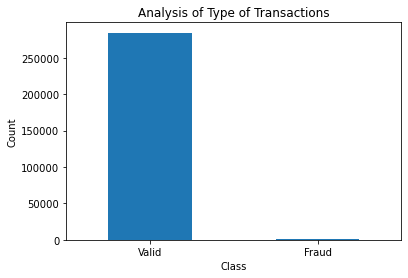

<Figure size 432x288 with 0 Axes>

In [ ]:
labels = ["Valid", "Fraud"]
count_classes = data.value_counts(data['Class'], sort= True)
count_classes.plot(kind = "bar", rot = 0)
plt.title("Analysis of Type of Transactions")
plt.ylabel("Count")
plt.xticks(range(2), labels)
plt.show()
plt.savefig(f"./images/CreditFraudClasses.png")

In [ ]:
# Standardization of features
df_pd = pd.read_csv("./data/creditcard.csv")
X = df_pd
y = df_pd['Class']
le = LabelEncoder()
X['Class'] = le.fit_transform(X['Class'])
y = le.transform(y)

In [ ]:
X.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


In [ ]:
# Feature Scaling
cols = X.columns
ms = MinMaxScaler()
X = ms.fit_transform(X)
X = pd.DataFrame(X, columns=[cols])

In [ ]:
X.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.000000,0.935192,0.766490,0.881365,0.313023,0.763439,0.267669,0.266815,0.786444,0.475312,...,0.561184,0.522992,0.663793,0.391253,0.585122,0.394557,0.418976,0.312697,0.005824,0.0
1,0.000000,0.978542,0.770067,0.840298,0.271796,0.766120,0.262192,0.264875,0.786298,0.453981,...,0.557840,0.480237,0.666938,0.336440,0.587290,0.446013,0.416345,0.313423,0.000105,0.0
2,0.000006,0.935217,0.753118,0.868141,0.268766,0.762329,0.281122,0.270177,0.788042,0.410603,...,0.565477,0.546030,0.678939,0.289354,0.559515,0.402727,0.415489,0.311911,0.014739,0.0
3,0.000006,0.941878,0.765304,0.868484,0.213661,0.765647,0.275559,0.266803,0.789434,0.414999,...,0.559734,0.510277,0.662607,0.223826,0.614245,0.389197,0.417669,0.314371,0.004807,0.0
4,0.000012,0.938617,0.776520,0.864251,0.269796,0.762975,0.263984,0.268968,0.782484,0.490950,...,0.561327,0.547271,0.663392,0.401270,0.566343,0.507497,0.420561,0.317490,0.002724,0.0


# K-Means Clustering

In [ ]:
inertia = []
k_val = []
accuracy = []
for k in range(1,50):
    kmeans = KMeans(n_clusters=k, random_state=0) 
    kmeans.fit(X)
    inertia.append(kmeans.inertia_)
    k_val.append(k)
    labels = kmeans.labels_
    correct_labels = sum(y == labels)
    acc = correct_labels/float(y.size)
    accuracy.append(acc)

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.
  warnings.warn(
/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.
  warnings.warn(
/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.
  warnings.warn(
/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.
  warnings.wa

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.
  warnings.warn(
/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.
  warnings.warn(
/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.
  warnings.warn(
/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.
  warnings.wa

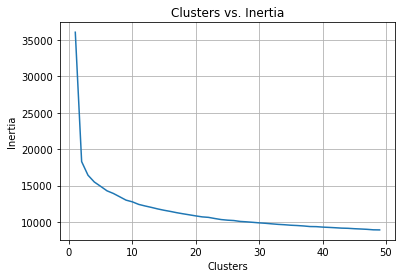

In [ ]:
plt.plot(k_val,inertia)
plt.xlabel('Clusters')
plt.ylabel('Inertia')
plt.title('Clusters vs. Inertia')
plt.grid()
plt.savefig('./images/cc_kmeans_clusters_vs_inertia.png')
plt.show()

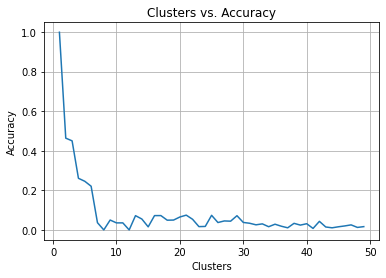

In [ ]:
plt.plot(k_val,accuracy)
plt.xlabel('Clusters')
plt.ylabel('Accuracy')
plt.title('Clusters vs. Accuracy')
plt.grid()
plt.savefig('./images/cc_kmeans_clusters_vs_accuracy.png')
plt.show()

For K=1 we observed 99.8% accuracy and K=2 we observed 46.34% accuracy on creditcard fraud dataset

Now we will use Elbow method to find the optimal value for number of clusters K

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.
  warnings.warn(
/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.
  warnings.warn(
/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.
  warnings.warn(
/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.
  warnings.wa

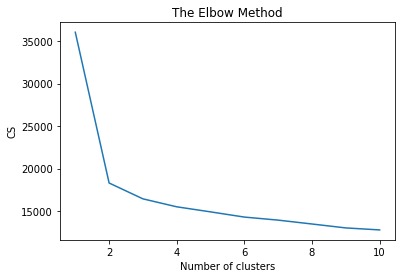

In [ ]:
cs = []
for i in range(1, 11):
    kmeans = KMeans(n_clusters = i, init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0)
    kmeans.fit(X)
    cs.append(kmeans.inertia_)
plt.plot(range(1, 11), cs)
plt.title('The Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('CS')
plt.savefig('./images/cc_kmeans_elbow_method.png')
plt.show()

From the above graph, we can clearly see there is a kink at K=2, Hence k <= 2 can be considered a good number of the cluster to cluster this data.

In [ ]:
kmeans = KMeans(n_clusters=1,random_state=0)
kmeans.fit(X)
y_kmeans = kmeans.predict(X)
labels = kmeans.labels_
centers = kmeans.cluster_centers_
# check how many of the samples were correctly labeled
correct_labels = sum(y == labels)
print("Result: %d out of %d samples were correctly labeled." % (correct_labels, y.size))
print('Accuracy score: {0:0.2f}'. format(correct_labels/float(y.size)))

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.
  warnings.warn(
/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.
  warnings.warn(


Result: 284315 out of 284807 samples were correctly labeled.
Accuracy score: 1.00


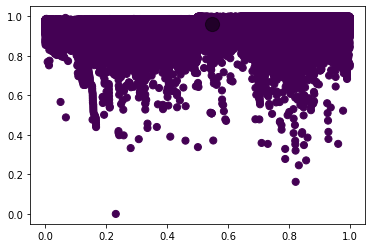

In [ ]:
plt.scatter(X.iloc[:, 0], X.iloc[:, 1], c=y_kmeans, s=50, cmap='viridis')
plt.scatter(centers[:, 0], centers[:, 1], c='black', s=200, alpha=0.5);
plt.savefig('./images/cc_kmeans_clusters.png')

# Expectation Maximization (EM)

In [ ]:
#reference: https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html
def get_kmeans_elbow(X, title):
    clusters = [x for x in range(2,5)]
    sil_scores = {}
    for cluster in tqdm(clusters):
        clusterer = KMeans(n_clusters=cluster, random_state=27)
        cluster_labels = clusterer.fit_predict(X)
        sil_score = silhouette_score(X, cluster_labels)
        sil_scores[cluster] = sil_score
    plt.plot(sil_scores.keys(), sil_scores.values(), label="kmeans")
    
    sil_scores = {}
    for cluster in tqdm(clusters):
        clusterer = GaussianMixture(n_components=cluster, random_state=27, reg_covar=1e-4)
        cluster_labels = clusterer.fit_predict(X)
        sil_score = silhouette_score(X, cluster_labels)
        sil_scores[cluster] = sil_score
    plt.plot(sil_scores.keys(), sil_scores.values(), label="gmm")
    plt.xlabel("No. of clusters")
    plt.ylabel("Silhoutte Coefficient")
    plt.title(title)
    plt.legend()
    plt.savefig('./images/Silhoutte_Coefficient_vs_K_for_Creditcard_fraud_dataset.png')
    plt.show()

In [ ]:
get_kmeans_elbow(X, "Silhoutte Coefficient vs K for Creditcard fraud dataset")

In [ ]:
homogeneity_score(KMeans(n_clusters=1, random_state=0).fit_predict(X), y)

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.
  warnings.warn(


1.0

In [ ]:
homogeneity_score(GaussianMixture(n_components=1, random_state=0, reg_covar=1e-4).fit_predict(X), y)

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.
  warnings.warn(


1.0

In [ ]:
data_with_clusters = df_pd
data_with_clusters["cluster"] = KMeans(n_clusters=1, random_state=0).fit_predict(X)

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.
  warnings.warn(


In [ ]:
data_with_clusters.corr()["cluster"].abs().sort_values().index[-50:]

Index(['Time', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10',
       'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20',
       'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'Amount',
       'Class', 'cluster'],
      dtype='object')

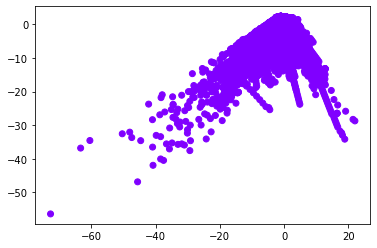

In [ ]:
plt.scatter(data_with_clusters['V2'],data_with_clusters['V1'],c=data_with_clusters['cluster'],cmap='rainbow')
plt.savefig('./images/cc_kmeans_clusters1.png')

In [ ]:
import plotly.express as px
fig = px.scatter_3d(df_pd, x='V1', y='V3', z='Class',
              color='cluster')
fig.show()
plt.savefig('./images/cc_kmeans_clusters_3d.png')

<Figure size 432x288 with 0 Axes>

# Dimensionality Reduction

PCA (Principal component analysis)

ICA (Independent component analysis)

RP (Randomized Projections)

LDA (LinearDiscriminantAnalysis)

# PCA

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/

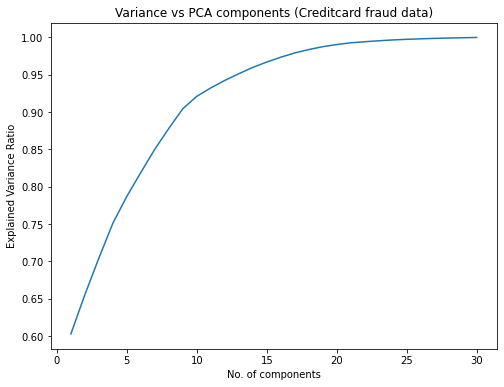

<Figure size 576x432 with 0 Axes>

In [ ]:
exp = {}
plt.rcParams["figure.figsize"] = (8,6)
for i in range(1, 31):
    pca = PCA(n_components=i)
    pca.fit(X)
    exp[i] = sum(pca.explained_variance_ratio_)
plt.plot(exp.keys(), exp.values())
plt.xlabel("No. of components")
plt.ylabel("Explained Variance Ratio")
plt.title("Variance vs PCA components (Creditcard fraud data)")
plt.show()
plt.savefig('./images/cc_variance_vs_pca_components.png')

In [ ]:
pca = PCA(n_components=5)
X_PCA = pca.fit_transform(X)
X_PCA_train, X_PCA_test, y_PCA_train, y_PCA_test = train_test_split(X_PCA, y, test_size=0.3, random_state=0)

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.



In [ ]:
x_pca = pd.DataFrame(X_PCA)

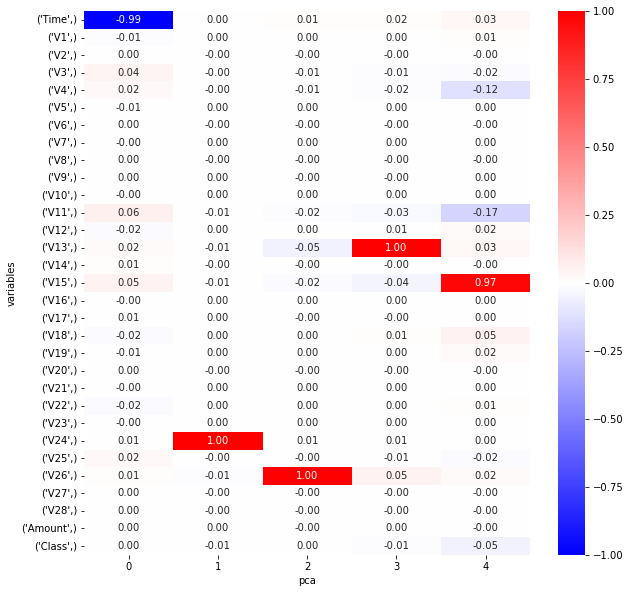

In [ ]:
# Visualization by heatmap
plt.figure(figsize=(10,10))
hm = sns.heatmap(pca.components_.T, cbar=True, annot=True, cmap='bwr', fmt=".2f", 
                 annot_kws={"size":10}, yticklabels=X.columns.tolist(), xticklabels=x_pca.columns, vmax=1, vmin=-1, center=0)
plt.xlabel("pca")
plt.ylabel("variables")
plt.savefig('./images/cc_pcs_heatmap.png')

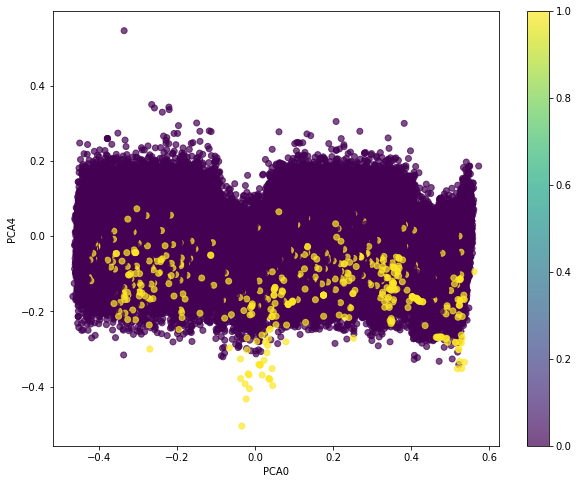

In [ ]:
# visualization by plot
x1 = x_pca[0]
y1 = x_pca[4]
c = y

plt.figure(figsize=(10,8))
plt.scatter(x1, y1, c=c, alpha=0.7)
plt.xlabel("PCA0")
plt.ylabel("PCA4")
plt.colorbar()
plt.savefig('./images/cc_pca_scatter_plot.png')

# ICA

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/

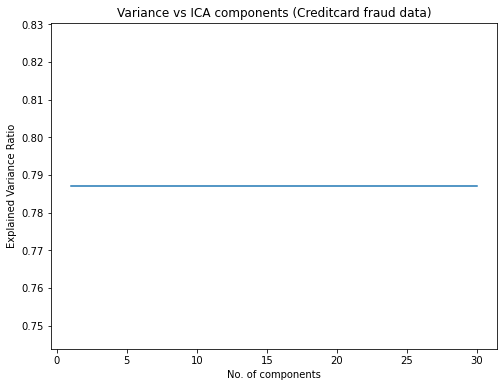

<Figure size 576x432 with 0 Axes>

In [ ]:
exp = {}
plt.rcParams["figure.figsize"] = (8,6)
for i in range(1, 31):
    ica = FastICA(n_components=i)
    ica.fit(X)
    exp[i] = sum(pca.explained_variance_ratio_)
plt.plot(exp.keys(), exp.values())
plt.xlabel("No. of components")
plt.ylabel("Explained Variance Ratio")
plt.title("Variance vs ICA components (Creditcard fraud data)")
plt.show()
plt.savefig('./images/cc_variance_vs_ica_components.png')

In [ ]:
ica = FastICA(n_components=5)
X_ICA = ica.fit_transform(X)
X_ICA_train, X_ICA_test, y_ICA_train, y_ICA_test = train_test_split(X_ICA, y, test_size=0.3, random_state=0)

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.



In [ ]:
x_ica = pd.DataFrame(X_ICA)

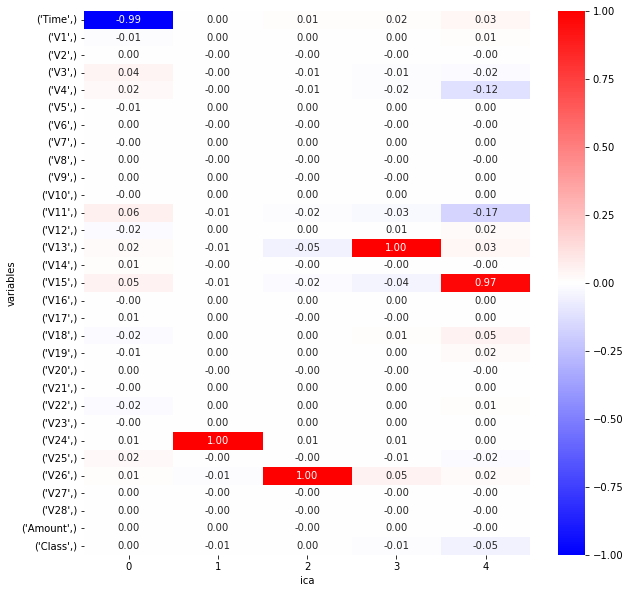

In [ ]:
# Visualization by heatmap
plt.figure(figsize=(10,10))
hm = sns.heatmap(pca.components_.T, cbar=True, annot=True, cmap='bwr', fmt=".2f", 
                 annot_kws={"size":10}, yticklabels=X.columns.tolist(), xticklabels=x_ica.columns, vmax=1, vmin=-1, center=0)
plt.xlabel("ica")
plt.ylabel("variables")
plt.savefig('./images/cc_ica_heatmap.png')

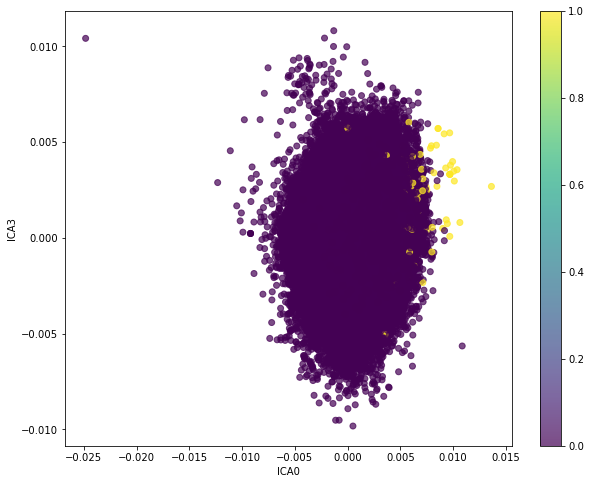

In [ ]:
# visualization by plot
x2 = x_ica[0]
y2 = x_ica[3]
c = y

plt.figure(figsize=(10,8))
plt.scatter(x2, y2, c=c, alpha=0.7)
plt.xlabel("ICA0")
plt.ylabel("ICA3")
plt.colorbar()
plt.savefig('./images/cc_ica_scatter_plot.png')

# RP

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/

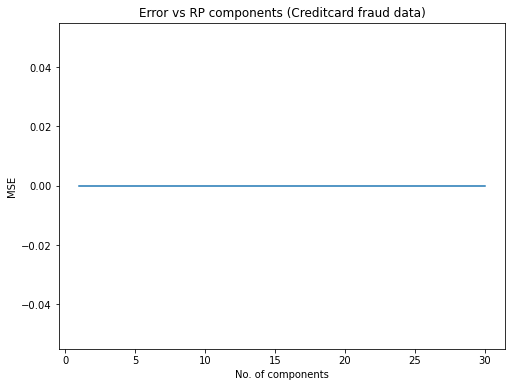

<Figure size 576x432 with 0 Axes>

In [ ]:
exp = {}
plt.rcParams["figure.figsize"] = (8,6)
for i in range(1, 31):
    rp = GaussianRandomProjection(n_components=i)
    rp.fit(X)
    w = rp.components_
    p = pinv(w)
    reconstructed = ((p@w)@(X.T)).T
    exp[i] = np.std(mean_squared_error(X,reconstructed))
plt.plot(exp.keys(), exp.values())
plt.xlabel("No. of components")
plt.ylabel("MSE")
plt.title("Error vs RP components (Creditcard fraud data)")
plt.show()
plt.savefig('./images/cc_mse_vs_rp_components.png')

In [ ]:
rp = GaussianRandomProjection(n_components=5)
X_RP = rp.fit_transform(X)
X_RP_train, X_RP_test, y_RP_train, y_RP_test = train_test_split(X_RP, y, test_size=0.3, random_state=0)

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.



In [ ]:
x_rp = pd.DataFrame(X_RP)

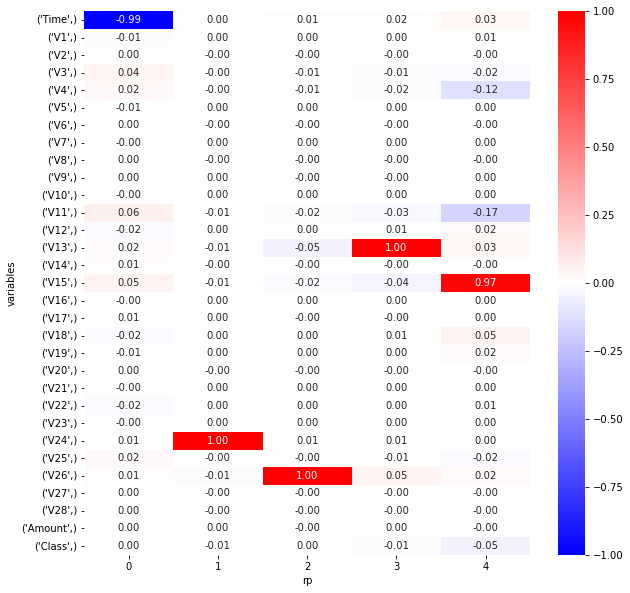

In [ ]:
# Visualization by heatmap
plt.figure(figsize=(10,10))
hm = sns.heatmap(pca.components_.T, cbar=True, annot=True, cmap='bwr', fmt=".2f", 
                 annot_kws={"size":10}, yticklabels=X.columns.tolist(), xticklabels=x_rp.columns, vmax=1, vmin=-1, center=0)
plt.xlabel("rp")
plt.ylabel("variables")
plt.savefig('./images/cc_rp_heatmap.png')

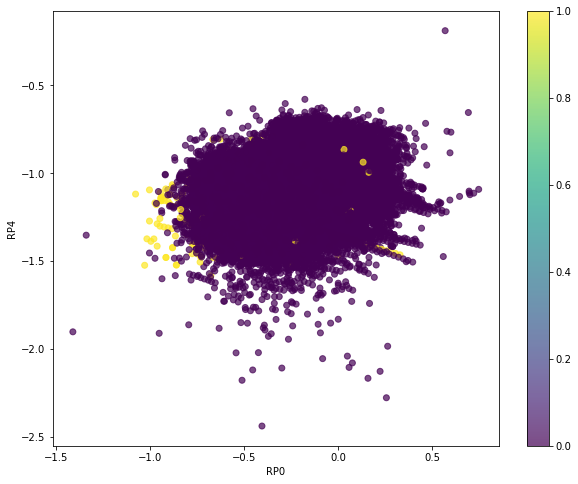

In [ ]:
# visualization by plot
x3 = x_rp[0]
y3 = x_rp[4]
c = y

plt.figure(figsize=(10,8))
plt.scatter(x3, y3, c=c, alpha=0.7)
plt.xlabel("RP0")
plt.ylabel("RP4")
plt.colorbar()
plt.savefig('./images/cc_rp_scatter_plot.png')

# LDA

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/

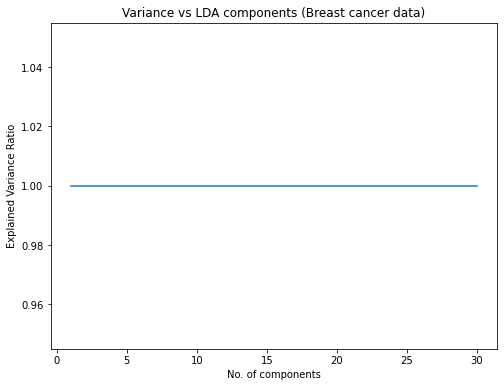

<Figure size 576x432 with 0 Axes>

In [ ]:
exp = {}
plt.rcParams["figure.figsize"] = (8,6)
for i in range(1, 31):
    lda = LinearDiscriminantAnalysis()
    lda.fit(X,y)
    exp[i] = sum(lda.explained_variance_ratio_)
plt.plot(exp.keys(), exp.values())
plt.xlabel("No. of components")
plt.ylabel("Explained Variance Ratio")
plt.title("Variance vs LDA components (Breast cancer data)")
plt.show()
plt.savefig('./images/cc_variance_vs_lda_components.png')

In [ ]:
lda = LinearDiscriminantAnalysis()
X_LDA = lda.fit_transform(X,y)
X_LDA_train, X_LDA_test, y_LDA_train, y_LDA_test = train_test_split(X_LDA, y, test_size=0.3, random_state=0)

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.



In [ ]:
x_lda = pd.DataFrame(X_LDA)

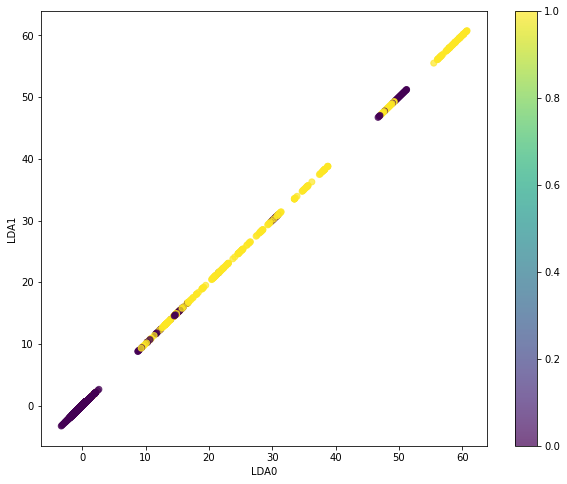

In [ ]:
# visualization by plot
x4 = x_lda[0]
y4 = x_lda[0]
c = y

plt.figure(figsize=(10,8))
plt.scatter(x4, y4, c=c, alpha=0.7)
plt.xlabel("LDA0")
plt.ylabel("LDA1")
plt.colorbar()
plt.savefig('./images/cc_lda_scatter_plot.png')

# Clustering on Dimensionally Reduced Data

# K Means on PCA Data

In [ ]:
inertia_pca = []
k_val_pca = []
accuracy_pca = []
for k in range(1,50):
    kmeans_pca = KMeans(n_clusters=k, random_state=0) 
    kmeans_pca.fit(X_PCA)
    inertia_pca.append(kmeans_pca.inertia_)
    k_val_pca.append(k)
    labels_pca = kmeans_pca.labels_
    correct_labels = sum(y == labels_pca)
    acc = correct_labels/float(y.size)
    accuracy_pca.append(acc)

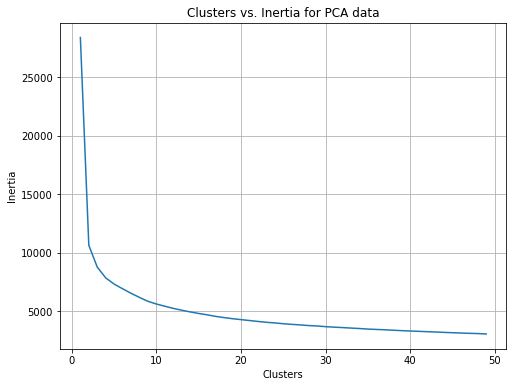

In [ ]:
plt.plot(k_val_pca,inertia_pca)
plt.xlabel('Clusters')
plt.ylabel('Inertia')
plt.title('Clusters vs. Inertia for PCA data')
plt.grid()
plt.savefig('./images/cc_kmeans_clusters_vs_inertia_pca.png')
plt.show()

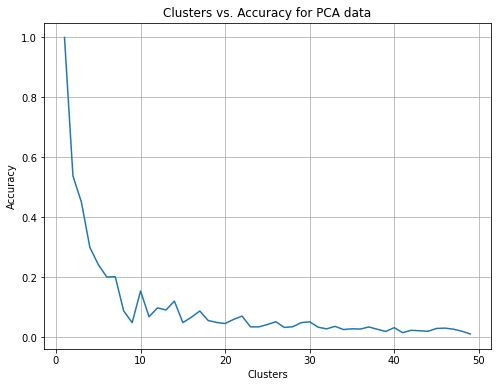

In [ ]:
plt.plot(k_val_pca,accuracy_pca)
plt.xlabel('Clusters')
plt.ylabel('Accuracy')
plt.title('Clusters vs. Accuracy for PCA data')
plt.grid()
plt.savefig('./images/cc_kmeans_clusters_vs_accuracy_pca.png')
plt.show()

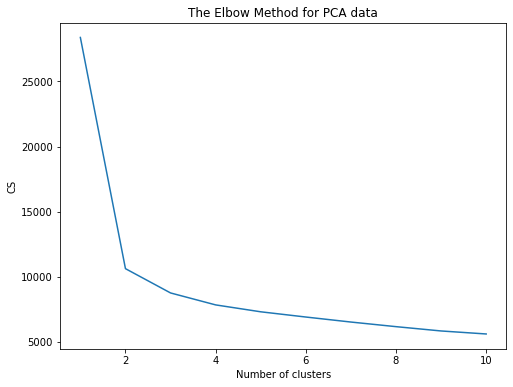

In [ ]:
cs = []
for i in range(1, 11):
    kmeans_pca = KMeans(n_clusters = i, init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0)
    kmeans_pca.fit(X_PCA)
    cs.append(kmeans_pca.inertia_)
plt.plot(range(1, 11), cs)
plt.title('The Elbow Method for PCA data')
plt.xlabel('Number of clusters')
plt.ylabel('CS')
plt.savefig('./images/cc_kmeans_elbow_method_pca.png')
plt.show()

In [ ]:
kmeans_PCA = KMeans(n_clusters=1,random_state=0)
kmeans_PCA.fit(X_PCA)
y_kmeans_PCA = kmeans_PCA.predict(X_PCA)
labels_PCA = kmeans_PCA.labels_
centers_PCA = kmeans_PCA.cluster_centers_
# check how many of the samples were correctly labeled
correct_labels_PCA = sum(y == labels_PCA)
print("Result: %d out of %d samples were correctly labeled." % (correct_labels_PCA, y.size))
print('Accuracy score: {0:0.2f}'. format(correct_labels_PCA/float(y.size)))

Result: 284315 out of 284807 samples were correctly labeled.
Accuracy score: 1.00


# K Means on ICA Data

In [ ]:
inertia_ica = []
k_val_ica = []
accuracy_ica = []
for k in range(1,50):
    kmeans_ica = KMeans(n_clusters=k, random_state=0) 
    kmeans_ica.fit(X_ICA)
    inertia_ica.append(kmeans_ica.inertia_)
    k_val_ica.append(k)
    labels_ica = kmeans_ica.labels_
    correct_labels = sum(y == labels_ica)
    acc = correct_labels/float(y.size)
    accuracy_ica.append(acc)

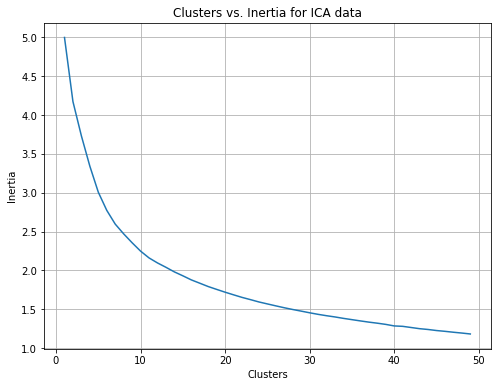

In [ ]:
plt.plot(k_val_ica,inertia_ica)
plt.xlabel('Clusters')
plt.ylabel('Inertia')
plt.title('Clusters vs. Inertia for ICA data')
plt.grid()
plt.savefig('./images/cc_kmeans_clusters_vs_inertia_ica.png')
plt.show()

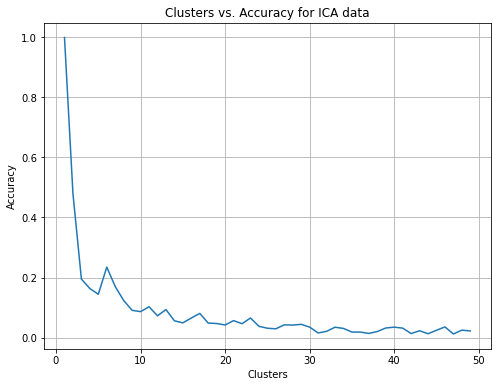

In [ ]:
plt.plot(k_val_ica,accuracy_ica)
plt.xlabel('Clusters')
plt.ylabel('Accuracy')
plt.title('Clusters vs. Accuracy for ICA data')
plt.grid()
plt.savefig('./images/cc_kmeans_clusters_vs_accuracy_Ica.png')
plt.show()

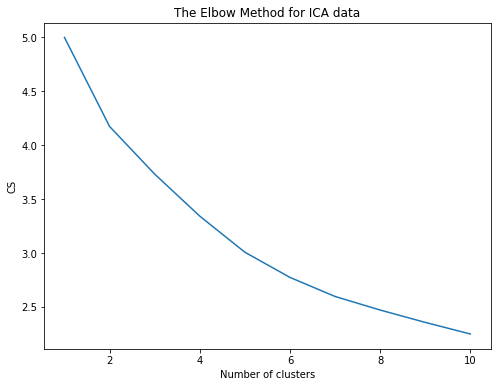

In [ ]:
cs = []
for i in range(1, 11):
    kmeans_ica = KMeans(n_clusters = i, init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0)
    kmeans_ica.fit(X_ICA)
    cs.append(kmeans_ica.inertia_)
plt.plot(range(1, 11), cs)
plt.title('The Elbow Method for ICA data')
plt.xlabel('Number of clusters')
plt.ylabel('CS')
plt.savefig('./images/cc_kmeans_elbow_method_ica.png')
plt.show()

In [ ]:
kmeans_ICA = KMeans(n_clusters=1,random_state=0)
kmeans_ICA.fit(X_ICA)
y_kmeans_ICA = kmeans_ICA.predict(X_ICA)
labels_ICA = kmeans_ICA.labels_
centers_ICA = kmeans_ICA.cluster_centers_
# check how many of the samples were correctly labeled
correct_labels_ICA = sum(y == labels_ICA)
print("Result: %d out of %d samples were correctly labeled." % (correct_labels_ICA, y.size))
print('Accuracy score: {0:0.2f}'. format(correct_labels_ICA/float(y.size)))

Result: 284315 out of 284807 samples were correctly labeled.
Accuracy score: 1.00


# K Means on RP data

In [ ]:
inertia_rp = []
k_val_rp = []
accuracy_rp = []
for k in range(1,50):
    kmeans_rp = KMeans(n_clusters=k, random_state=0) 
    kmeans_rp.fit(X_RP)
    inertia_rp.append(kmeans_rp.inertia_)
    k_val_rp.append(k)
    labels_rp = kmeans_rp.labels_
    correct_labels = sum(y == labels_rp)
    acc = correct_labels/float(y.size)
    accuracy_rp.append(acc)

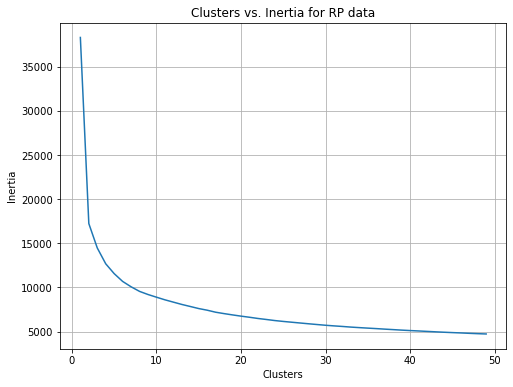

In [ ]:
plt.plot(k_val_rp,inertia_rp)
plt.xlabel('Clusters')
plt.ylabel('Inertia')
plt.title('Clusters vs. Inertia for RP data')
plt.grid()
plt.savefig('./images/cc_kmeans_clusters_vs_inertia_rp.png')
plt.show()

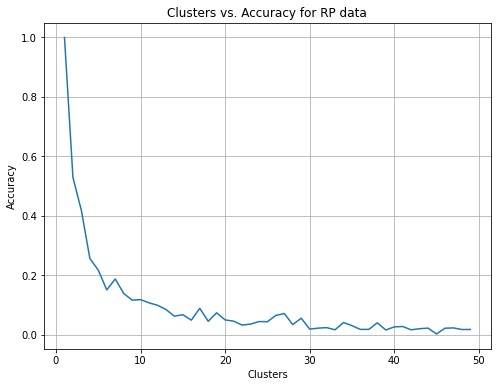

In [ ]:
plt.plot(k_val_rp,accuracy_rp)
plt.xlabel('Clusters')
plt.ylabel('Accuracy')
plt.title('Clusters vs. Accuracy for RP data')
plt.grid()
plt.savefig('./images/cc_kmeans_clusters_vs_accuracy_rp.png')
plt.show()

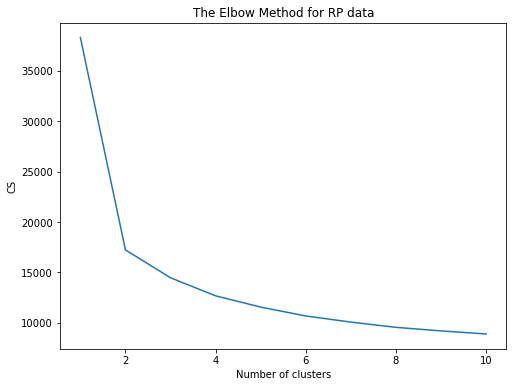

In [ ]:
cs = []
for i in range(1, 11):
    kmeans_rp = KMeans(n_clusters = i, init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0)
    kmeans_rp.fit(X_RP)
    cs.append(kmeans_rp.inertia_)
plt.plot(range(1, 11), cs)
plt.title('The Elbow Method for RP data')
plt.xlabel('Number of clusters')
plt.ylabel('CS')
plt.savefig('./images/cc_kmeans_elbow_method_rp.png')
plt.show()

In [ ]:
kmeans_RP = KMeans(n_clusters=1,random_state=0)
kmeans_RP.fit(X_RP)
y_kmeans_RP = kmeans_RP.predict(X_RP)
labels_RP = kmeans_RP.labels_
centers_RP = kmeans_RP.cluster_centers_
# check how many of the samples were correctly labeled
correct_labels_RP = sum(y == labels_RP)
print("Result: %d out of %d samples were correctly labeled." % (correct_labels_RP, y.size))
print('Accuracy score: {0:0.2f}'. format(correct_labels_RP/float(y.size)))

Result: 284315 out of 284807 samples were correctly labeled.
Accuracy score: 1.00


# K Means on LDA Data

In [ ]:
inertia_lda = []
k_val_lda = []
accuracy_lda = []
for k in range(1,50):
    kmeans_lda = KMeans(n_clusters=k, random_state=0) 
    kmeans_lda.fit(X_LDA)
    inertia_lda.append(kmeans_lda.inertia_)
    k_val_lda.append(k)
    labels_lda = kmeans_lda.labels_
    correct_labels = sum(y == labels_lda)
    acc = correct_labels/float(y.size)
    accuracy_lda.append(acc)

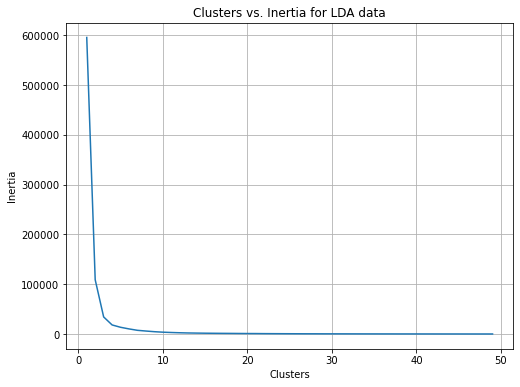

In [ ]:
plt.plot(k_val_lda,inertia_lda)
plt.xlabel('Clusters')
plt.ylabel('Inertia')
plt.title('Clusters vs. Inertia for LDA data')
plt.grid()
plt.savefig('./images/cc_kmeans_clusters_vs_inertia_lda.png')
plt.show()

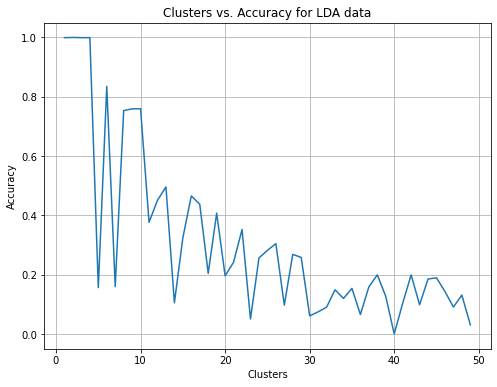

In [ ]:
plt.plot(k_val_lda,accuracy_lda)
plt.xlabel('Clusters')
plt.ylabel('Accuracy')
plt.title('Clusters vs. Accuracy for LDA data')
plt.grid()
plt.savefig('./images/cc_kmeans_clusters_vs_accuracy_lda.png')
plt.show()

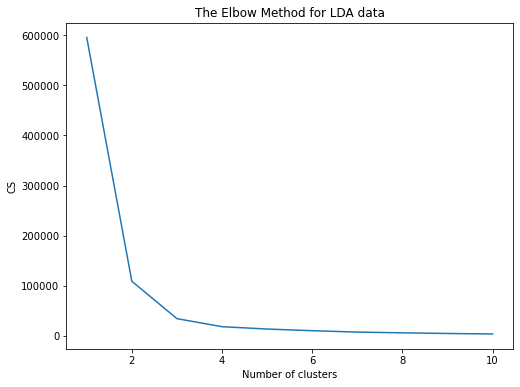

In [ ]:
cs = []
for i in range(1, 11):
    kmeans_lda = KMeans(n_clusters = i, init = 'k-means++', max_iter = 300, n_init = 10, random_state = 0)
    kmeans_lda.fit(X_LDA)
    cs.append(kmeans_lda.inertia_)
plt.plot(range(1, 11), cs)
plt.title('The Elbow Method for LDA data')
plt.xlabel('Number of clusters')
plt.ylabel('CS')
plt.savefig('./images/cc_kmeans_elbow_method_lda.png')
plt.show()

In [ ]:
kmeans_LDA = KMeans(n_clusters=2,random_state=0)
kmeans_LDA.fit(X_LDA)
y_kmeans_LDA = kmeans_LDA.predict(X_LDA)
labels_LDA = kmeans_LDA.labels_
centers_LDA = kmeans_LDA.cluster_centers_
# check how many of the samples were correctly labeled
correct_labels_LDA = sum(y == labels_LDA)
print("Result: %d out of %d samples were correctly labeled." % (correct_labels_LDA, y.size))
print('Accuracy score: {0:0.2f}'. format(correct_labels_LDA/float(y.size)))

Result: 284533 out of 284807 samples were correctly labeled.
Accuracy score: 1.00


# Neural Networks on Dimensionally Reduced data

First we will apply Neural Networks on original creditcard fraud dataset to check its performance

In [ ]:
start_time = time.time()
mlp = MLPClassifier(
    max_iter=1000,
    alpha=0.1,
    activation='logistic',
    solver='adam',
    random_state=42
)
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.33)
mlp.fit(X_train, y_train)

mlp_predict = mlp.predict(X_test)
mlp_predict_proba = mlp.predict_proba(X_test)[:, 1]
end_time = time.time()
time_infer = end_time-start_time

print('MLP Accuracy: {:.2f}%'.format(accuracy_score(y_test, mlp_predict) * 100))
print('MLP AUC: {:.2f}%'.format(roc_auc_score(y_test, mlp_predict_proba) * 100))
print('MLP Classification report:\n\n', classification_report(y_test, mlp_predict))
print('MLP Training set score: {:.2f}%'.format(mlp.score(X_train, y_train) * 100))
print('MLP Testing set score: {:.2f}%'.format(mlp.score(X_test, y_test) * 100))
print("Inference Time:",time_infer)

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.



MLP Accuracy: 99.83%
MLP AUC: 100.00%
MLP Classification report:

               precision    recall  f1-score   support

           0       1.00      1.00      1.00     93824
           1       0.00      0.00      0.00       163

    accuracy                           1.00     93987
   macro avg       0.50      0.50      0.50     93987
weighted avg       1.00      1.00      1.00     93987



/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature na

MLP Training set score: 99.83%
MLP Testing set score: 99.83%
Inference Time: 18.840710163116455


/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.



In [ ]:
# utils
def evaluation_metrics(y_test, y_pred, model):
    n_errors = (y_pred != y_test).sum() 
    print("The model used is " + str(model)) 
    acc = accuracy_score(y_test, y_pred) 
    print("The accuracy is {}".format(acc)) 
    prec = precision_score(y_test, y_pred) 
    print("The precision is {}".format(prec)) 
    rec = recall_score(y_test, y_pred) 
    print("The recall is {}".format(rec)) 
    f1 = f1_score(y_test, y_pred) 
    print("The F1-Score is {}".format(f1)) 
    MCC = matthews_corrcoef(y_test, y_pred) 
    print("The Matthews correlation coefficient is {}".format(MCC)) 
    AUC = roc_auc_score(y_test, y_pred)
    print("The ROC-AUC Score is {}".format(AUC)) 
    
def plot_confusion_matrix(y_test, y_pred, model,dataset):
    class_labels = ['NotFraud', 'Fraud'] 
    conf_matrix = confusion_matrix(y_test, y_pred) 
    plt.figure(figsize =(5, 5)) 
    sns.heatmap(conf_matrix, xticklabels = class_labels, yticklabels = class_labels, annot = True, fmt ="d"); 
    plt.title("Confusion matrix of " + str(model)) 
    plt.ylabel('True class') 
    plt.xlabel('Predicted class') 
    #plt.show() 
    plt.savefig(f"./images/" + dataset + "_" + str(model) + ".png")

The model used is MultiLayerPerceptronClassification
The accuracy is 0.9982657175992424
The precision is 0.0
The recall is 0.0
The F1-Score is 0.0
The Matthews correlation coefficient is 0.0
The ROC-AUC Score is 0.5


/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.



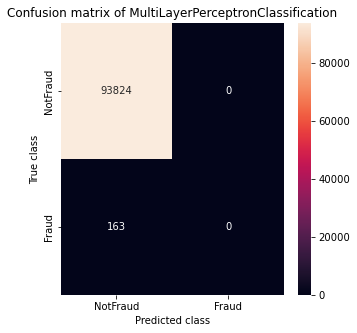

In [ ]:
y_pred = mlp_predict
evaluation_metrics(y_test,y_pred,"MultiLayerPerceptronClassification")
plot_confusion_matrix(y_test,y_pred,"MultiLayerPerceptronClassification","creditcardfraud")

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/

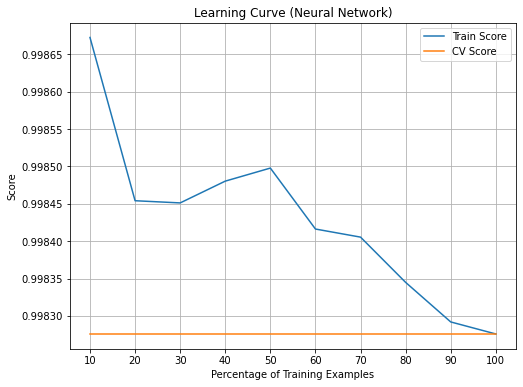

In [ ]:
# Learning Curve
classifier_neural_network_learning = mlp
_, train_scores, test_scores = learning_curve(classifier_neural_network_learning, X_train, y_train, train_sizes=np.linspace(0.1,1.0,10), cv=4)

plt.figure()
plt.plot(np.linspace(0.1,1.0,10)*100, np.mean(train_scores, axis=1), label='Train Score')
plt.plot(np.linspace(0.1,1.0,10)*100, np.mean(test_scores, axis=1), label='CV Score')
plt.legend()
plt.title("Learning Curve (Neural Network)")
plt.xlabel("Percentage of Training Examples")
plt.ylabel("Score")
plt.xticks(np.linspace(0.1,1.0,10)*100)
plt.grid()
plt.savefig('./images/cc_neural_network_learning_curve.png')
plt.show()

# MLP on PCA data

In [ ]:
start_time = time.time()
mlp_pca = MLPClassifier(
    max_iter=1000,
    alpha=0.1,
    activation='logistic',
    solver='adam',
    random_state=42
)

mlp_pca.fit(X_PCA_train, y_PCA_train)

mlp_predict_pca = mlp_pca.predict(X_PCA_test)
mlp_predict_proba_pca = mlp_pca.predict_proba(X_PCA_test)[:, 1]
end_time = time.time()
time_infer = end_time-start_time

print('MLP Accuracy: {:.2f}%'.format(accuracy_score(y_PCA_test, mlp_predict_pca) * 100))
print('MLP AUC: {:.2f}%'.format(roc_auc_score(y_PCA_test, mlp_predict_proba_pca) * 100))
print('MLP Classification report:\n\n', classification_report(y_PCA_test, mlp_predict_pca))
#print('MLP Training set score: {:.2f}%'.format(mlp.score(X_PCA_train, y_PCA_train) * 100))
#print('MLP Testing set score: {:.2f}%'.format(mlp.score(X_PCA_test, y_PCA_test) * 100))
print("Inference Time:",time_infer)

MLP Accuracy: 99.83%
MLP AUC: 68.24%
MLP Classification report:

               precision    recall  f1-score   support

           0       1.00      1.00      1.00     85296
           1       0.00      0.00      0.00       147

    accuracy                           1.00     85443
   macro avg       0.50      0.50      0.50     85443
weighted avg       1.00      1.00      1.00     85443

Inference Time: 12.460251092910767


/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



The model used is MultiLayerPerceptronClassification
The accuracy is 0.9982795547909132
The precision is 0.0
The recall is 0.0
The F1-Score is 0.0
The Matthews correlation coefficient is 0.0
The ROC-AUC Score is 0.5


/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.



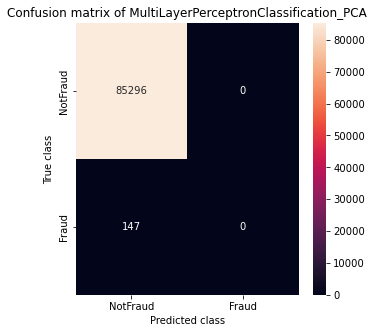

In [ ]:
y_pred_mlp_pca = mlp_predict_pca
evaluation_metrics(y_PCA_test,y_pred_mlp_pca,"MultiLayerPerceptronClassification")
plot_confusion_matrix(y_PCA_test,y_pred_mlp_pca,"MultiLayerPerceptronClassification_PCA","creditcardfraud")

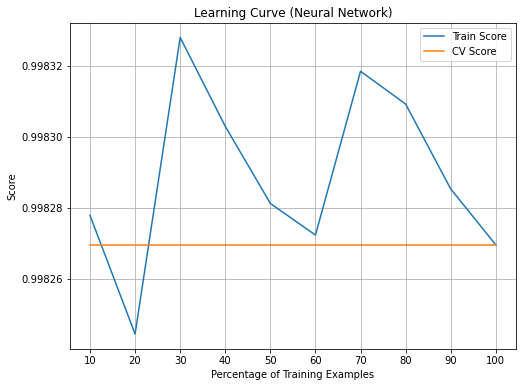

In [ ]:
# Learning Curve
classifier_neural_network_learning_pca = mlp_pca
_, train_scores, test_scores = learning_curve(classifier_neural_network_learning_pca, X_PCA_train, y_PCA_train, 
                                              train_sizes=np.linspace(0.1,1.0,10), cv=4)

plt.figure()
plt.plot(np.linspace(0.1,1.0,10)*100, np.mean(train_scores, axis=1), label='Train Score')
plt.plot(np.linspace(0.1,1.0,10)*100, np.mean(test_scores, axis=1), label='CV Score')
plt.legend()
plt.title("Learning Curve (Neural Network)")
plt.xlabel("Percentage of Training Examples")
plt.ylabel("Score")
plt.xticks(np.linspace(0.1,1.0,10)*100)
plt.grid()
plt.savefig('./images/cc_neural_network_learning_curve_pca.png')
plt.show()

# MLP on ICA data

In [ ]:
start_time = time.time()
mlp_ica = MLPClassifier(
    max_iter=1000,
    alpha=0.1,
    activation='logistic',
    solver='adam',
    random_state=42
)

mlp_ica.fit(X_ICA_train, y_ICA_train)

mlp_predict_ica = mlp_ica.predict(X_ICA_test)
mlp_predict_proba_ica = mlp_ica.predict_proba(X_ICA_test)[:, 1]
end_time = time.time()
time_infer = end_time-start_time

print('MLP Accuracy: {:.2f}%'.format(accuracy_score(y_ICA_test, mlp_predict_ica) * 100))
print('MLP AUC: {:.2f}%'.format(roc_auc_score(y_ICA_test, mlp_predict_proba_ica) * 100))
print('MLP Classification report:\n\n', classification_report(y_ICA_test, mlp_predict_ica))
#print('MLP Training set score: {:.2f}%'.format(mlp.score(X_ICA_train, y_ICA_train) * 100))
#print('MLP Testing set score: {:.2f}%'.format(mlp.score(X_ICA_test, y_ICA_test) * 100))
print("Inference Time:",time_infer)

MLP Accuracy: 99.83%
MLP AUC: 79.77%
MLP Classification report:

               precision    recall  f1-score   support

           0       1.00      1.00      1.00     85296
           1       0.00      0.00      0.00       147

    accuracy                           1.00     85443
   macro avg       0.50      0.50      0.50     85443
weighted avg       1.00      1.00      1.00     85443

Inference Time: 12.242398023605347


/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



The model used is MultiLayerPerceptronClassification
The accuracy is 0.9982795547909132
The precision is 0.0
The recall is 0.0
The F1-Score is 0.0
The Matthews correlation coefficient is 0.0
The ROC-AUC Score is 0.5


/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.



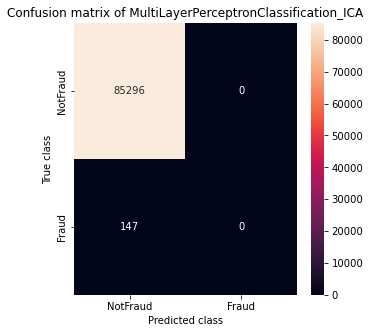

In [ ]:
y_pred_mlp_ica = mlp_predict_ica
evaluation_metrics(y_ICA_test,y_pred_mlp_ica,"MultiLayerPerceptronClassification")
plot_confusion_matrix(y_ICA_test,y_pred_mlp_ica,"MultiLayerPerceptronClassification_ICA","creditcardfraud")

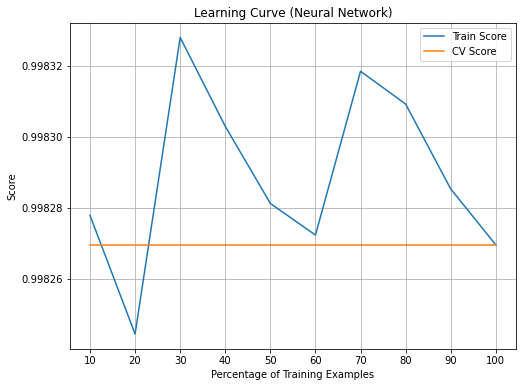

In [ ]:
# Learning Curve
classifier_neural_network_learning_ica = mlp_ica
_, train_scores, test_scores = learning_curve(classifier_neural_network_learning_ica, X_ICA_train, y_ICA_train, 
                                              train_sizes=np.linspace(0.1,1.0,10), cv=4)

plt.figure()
plt.plot(np.linspace(0.1,1.0,10)*100, np.mean(train_scores, axis=1), label='Train Score')
plt.plot(np.linspace(0.1,1.0,10)*100, np.mean(test_scores, axis=1), label='CV Score')
plt.legend()
plt.title("Learning Curve (Neural Network)")
plt.xlabel("Percentage of Training Examples")
plt.ylabel("Score")
plt.xticks(np.linspace(0.1,1.0,10)*100)
plt.grid()
plt.savefig('./images/cc_neural_network_learning_curve_ica.png')
plt.show()

# MLP on RP data

In [ ]:
start_time = time.time()
mlp_rp = MLPClassifier(
    max_iter=1000,
    alpha=0.1,
    activation='logistic',
    solver='adam',
    random_state=42
)

mlp_rp.fit(X_RP_train, y_RP_train)

mlp_predict_rp = mlp_rp.predict(X_RP_test)
mlp_predict_proba_rp = mlp_rp.predict_proba(X_RP_test)[:, 1]
end_time = time.time()
time_infer = end_time-start_time

print('MLP Accuracy: {:.2f}%'.format(accuracy_score(y_RP_test, mlp_predict_rp) * 100))
print('MLP AUC: {:.2f}%'.format(roc_auc_score(y_RP_test, mlp_predict_proba_rp) * 100))
print('MLP Classification report:\n\n', classification_report(y_RP_test, mlp_predict_rp))
#print('MLP Training set score: {:.2f}%'.format(mlp.score(X_RP_train, y_RP_train) * 100))
#print('MLP Testing set score: {:.2f}%'.format(mlp.score(X_RP_test, y_RP_test) * 100))
print("Inference Time:",time_infer)

MLP Accuracy: 99.83%
MLP AUC: 95.39%
MLP Classification report:

               precision    recall  f1-score   support

           0       1.00      1.00      1.00     85296
           1       0.00      0.00      0.00       147

    accuracy                           1.00     85443
   macro avg       0.50      0.50      0.50     85443
weighted avg       1.00      1.00      1.00     85443

Inference Time: 14.438245058059692


/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



The model used is MultiLayerPerceptronClassification
The accuracy is 0.9982795547909132
The precision is 0.0
The recall is 0.0
The F1-Score is 0.0
The Matthews correlation coefficient is 0.0
The ROC-AUC Score is 0.5


/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.



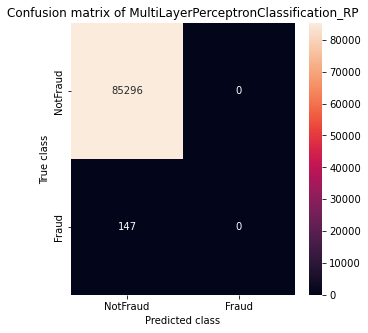

In [ ]:
y_pred_mlp_rp = mlp_predict_rp
evaluation_metrics(y_RP_test,y_pred_mlp_rp,"MultiLayerPerceptronClassification")
plot_confusion_matrix(y_RP_test,y_pred_mlp_rp,"MultiLayerPerceptronClassification_RP","creditcardfraud")

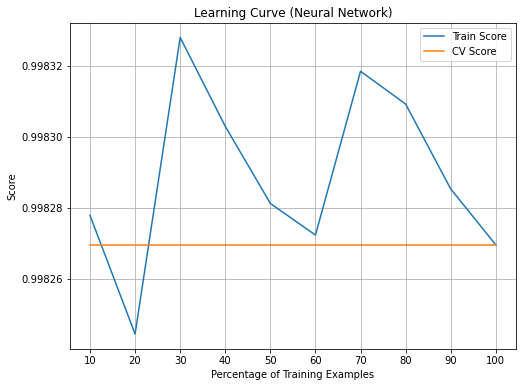

In [ ]:
# Learning Curve
classifier_neural_network_learning_rp = mlp_rp
_, train_scores, test_scores = learning_curve(classifier_neural_network_learning_rp, X_RP_train, y_RP_train, 
                                              train_sizes=np.linspace(0.1,1.0,10), cv=4)

plt.figure()
plt.plot(np.linspace(0.1,1.0,10)*100, np.mean(train_scores, axis=1), label='Train Score')
plt.plot(np.linspace(0.1,1.0,10)*100, np.mean(test_scores, axis=1), label='CV Score')
plt.legend()
plt.title("Learning Curve (Neural Network)")
plt.xlabel("Percentage of Training Examples")
plt.ylabel("Score")
plt.xticks(np.linspace(0.1,1.0,10)*100)
plt.grid()
plt.savefig('./images/cc_neural_network_learning_curve_rp.png')
plt.show()

# MLP on LDA data

In [ ]:
start_time = time.time()
mlp_lda = MLPClassifier(
    max_iter=1000,
    alpha=0.1,
    activation='logistic',
    solver='adam',
    random_state=42
)

mlp_lda.fit(X_LDA_train, y_LDA_train)

mlp_predict_lda = mlp_lda.predict(X_LDA_test)
mlp_predict_proba_lda = mlp_lda.predict_proba(X_LDA_test)[:, 1]
end_time = time.time()
time_infer = end_time-start_time

print('MLP Accuracy: {:.2f}%'.format(accuracy_score(y_LDA_test, mlp_predict_lda) * 100))
print('MLP AUC: {:.2f}%'.format(roc_auc_score(y_LDA_test, mlp_predict_proba_lda) * 100))
print('MLP Classification report:\n\n', classification_report(y_LDA_test, mlp_predict_lda))
#print('MLP Training set score: {:.2f}%'.format(mlp.score(X_LDA_train, y_LDA_train) * 100))
#print('MLP Testing set score: {:.2f}%'.format(mlp.score(X_LDA_test, y_LDA_test) * 100))
print("Inference Time:",time_infer)

MLP Accuracy: 99.94%
MLP AUC: 97.77%
MLP Classification report:

               precision    recall  f1-score   support

           0       1.00      1.00      1.00     85296
           1       0.88      0.74      0.80       147

    accuracy                           1.00     85443
   macro avg       0.94      0.87      0.90     85443
weighted avg       1.00      1.00      1.00     85443

Inference Time: 11.561014175415039


The model used is MultiLayerPerceptronClassification
The accuracy is 0.9993797034280163
The precision is 0.8790322580645161
The recall is 0.7414965986394558
The F1-Score is 0.8044280442804429
The Matthews correlation coefficient is 0.8070406864451448
The ROC-AUC Score is 0.8706603702257495


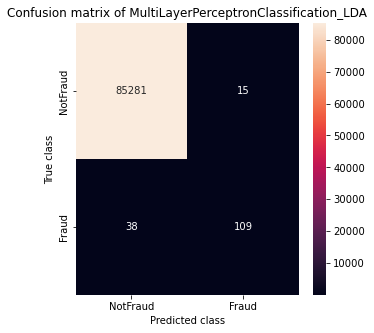

In [ ]:
y_pred_mlp_lda = mlp_predict_lda
evaluation_metrics(y_LDA_test,y_pred_mlp_lda,"MultiLayerPerceptronClassification")
plot_confusion_matrix(y_LDA_test,y_pred_mlp_lda,"MultiLayerPerceptronClassification_LDA","creditcardfraud")

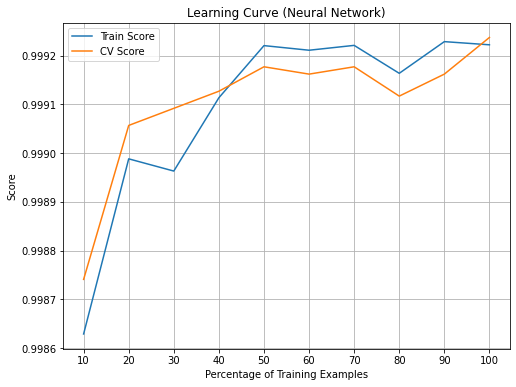

In [ ]:
# Learning Curve
classifier_neural_network_learning_lda = mlp_lda
_, train_scores, test_scores = learning_curve(classifier_neural_network_learning_lda, X_LDA_train, y_LDA_train, 
                                              train_sizes=np.linspace(0.1,1.0,10), cv=4)

plt.figure()
plt.plot(np.linspace(0.1,1.0,10)*100, np.mean(train_scores, axis=1), label='Train Score')
plt.plot(np.linspace(0.1,1.0,10)*100, np.mean(test_scores, axis=1), label='CV Score')
plt.legend()
plt.title("Learning Curve (Neural Network)")
plt.xlabel("Percentage of Training Examples")
plt.ylabel("Score")
plt.xticks(np.linspace(0.1,1.0,10)*100)
plt.grid()
plt.savefig('./images/cc_neural_network_learning_curve_lda.png')
plt.show()

# Neural Networks with Clustering (i.e Clusters as new features to dimensionally reduced data)

# K-Means

In [ ]:
k = 1
k_means_clustering = KMeans(n_clusters=k, random_state=42)
k_means_clustering.fit_transform(X)

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.



array([[0.57417886],
       [0.56618803],
       [0.6271394 ],
       ...,
       [0.48226802],
       [0.56242395],
       [0.47938405]])

In [ ]:
X_KMeans = np.append(X, k_means_clustering.fit_transform(X), 1)
X_KMeans_train, X_KMeans_test, y_KMeans_train, y_KMeans_test = train_test_split(X_KMeans, y, test_size=0.3, random_state=42)

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.



In [ ]:
start_time = time.time()
mlp_pca_kmeans = MLPClassifier(
    max_iter=1000,
    alpha=0.1,
    activation='logistic',
    solver='adam',
    random_state=42
)

mlp_pca_kmeans.fit(X_KMeans_train, y_KMeans_train)

mlp_predict_pca_kmeans = mlp_pca_kmeans.predict(X_KMeans_test)
mlp_predict_proba_pca_kmeans = mlp_pca_kmeans.predict_proba(X_KMeans_test)[:, 1]
end_time = time.time()
time_infer = end_time-start_time

print('MLP Accuracy: {:.2f}%'.format(accuracy_score(y_KMeans_test, mlp_predict_pca_kmeans) * 100))
print('MLP AUC: {:.2f}%'.format(roc_auc_score(y_KMeans_test, mlp_predict_proba_pca_kmeans) * 100))
print('MLP Classification report:\n\n', classification_report(y_KMeans_test, mlp_predict_pca_kmeans))
#print('MLP Training set score: {:.2f}%'.format(mlp.score(X_KMeans_train, y_KMeans_train) * 100))
#print('MLP Testing set score: {:.2f}%'.format(mlp.score(X_KMeans_test, y_KMeans_test) * 100))
print("Inference Time:",time_infer)

MLP Accuracy: 99.85%
MLP AUC: 100.00%
MLP Classification report:

               precision    recall  f1-score   support

           0       1.00      1.00      1.00     85307
           1       1.00      0.05      0.10       136

    accuracy                           1.00     85443
   macro avg       1.00      0.53      0.55     85443
weighted avg       1.00      1.00      1.00     85443

Inference Time: 30.062931060791016


The model used is MultiLayerPerceptronClassification
The accuracy is 0.9984902215512096
The precision is 1.0
The recall is 0.051470588235294115
The F1-Score is 0.09790209790209789
The Matthews correlation coefficient is 0.2266999618074704
The ROC-AUC Score is 0.5257352941176471


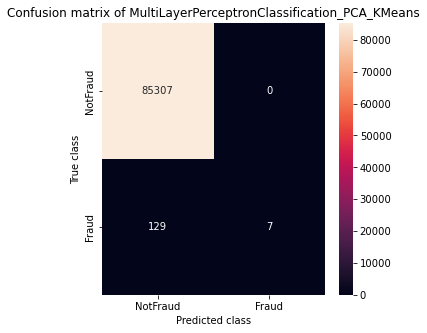

In [ ]:
y_pred_mlp_pca_kmeans = mlp_predict_pca_kmeans
evaluation_metrics(y_KMeans_test,y_pred_mlp_pca_kmeans,"MultiLayerPerceptronClassification")
plot_confusion_matrix(y_KMeans_test,y_pred_mlp_pca_kmeans,"MultiLayerPerceptronClassification_PCA_KMeans","creditcardfraud")

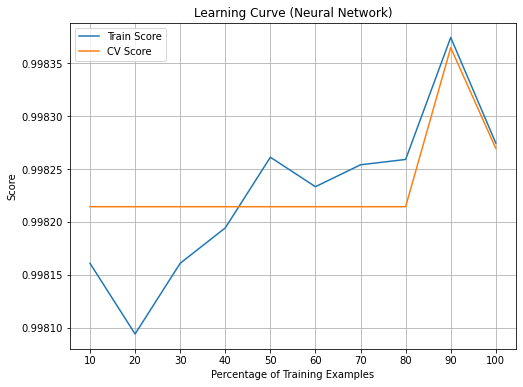

In [ ]:
# Learning Curve
classifier_neural_network_learning_pca_kmeans = mlp_pca_kmeans
_, train_scores, test_scores = learning_curve(classifier_neural_network_learning_pca_kmeans, X_KMeans_train, 
                                              y_KMeans_train, train_sizes=np.linspace(0.1,1.0,10), cv=4)

plt.figure()
plt.plot(np.linspace(0.1,1.0,10)*100, np.mean(train_scores, axis=1), label='Train Score')
plt.plot(np.linspace(0.1,1.0,10)*100, np.mean(test_scores, axis=1), label='CV Score')
plt.legend()
plt.title("Learning Curve (Neural Network)")
plt.xlabel("Percentage of Training Examples")
plt.ylabel("Score")
plt.xticks(np.linspace(0.1,1.0,10)*100)
plt.grid()
plt.savefig('./images/cc_neural_network_learning_curve_pca_kmeans.png')
plt.show()

# EM

In [ ]:
gmm = mixture.GaussianMixture(n_components=1, covariance_type='full')
gmm.fit(X)
gmm.predict_proba(X)

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.



array([[1.],
       [1.],
       [1.],
       ...,
       [1.],
       [1.],
       [1.]])

In [ ]:
X_GMM = np.append(X, gmm.predict_proba(X), 1)
X_GMM_train, X_GMM_test, y_GMM_train, y_GMM_test = train_test_split(X_GMM, y, test_size=0.3, random_state=42)

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/utils/validation.py:1688: FutureWarning:

Feature names only support names that are all strings. Got feature names with dtypes: ['tuple']. An error will be raised in 1.2.



In [ ]:
start_time = time.time()
mlp_pca_em = MLPClassifier(
    max_iter=1000,
    alpha=0.1,
    activation='logistic',
    solver='adam',
    random_state=42
)

mlp_pca_em.fit(X_GMM_train, y_GMM_train)

mlp_predict_pca_em = mlp_pca_em.predict(X_GMM_test)
mlp_predict_proba_pca_em = mlp_pca_em.predict_proba(X_GMM_test)[:, 1]
end_time = time.time()
time_infer = end_time-start_time

print('MLP Accuracy: {:.2f}%'.format(accuracy_score(y_GMM_test, mlp_predict_pca_em) * 100))
print('MLP AUC: {:.2f}%'.format(roc_auc_score(y_GMM_test, mlp_predict_proba_pca_em) * 100))
print('MLP Classification report:\n\n', classification_report(y_GMM_test, mlp_predict_pca_em))
#print('MLP Training set score: {:.2f}%'.format(mlp.score(X_GMM_train, y_GMM_train) * 100))
#print('MLP Testing set score: {:.2f}%'.format(mlp.score(X_GMM_test, y_GMM_test) * 100))
print("Inference Time:",time_infer)

MLP Accuracy: 99.84%
MLP AUC: 100.00%
MLP Classification report:

               precision    recall  f1-score   support

           0       1.00      1.00      1.00     85307
           1       0.00      0.00      0.00       136

    accuracy                           1.00     85443
   macro avg       0.50      0.50      0.50     85443
weighted avg       1.00      1.00      1.00     85443

Inference Time: 16.70622491836548


/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



The model used is MultiLayerPerceptronClassification
The accuracy is 0.9984082955888721
The precision is 0.0
The recall is 0.0
The F1-Score is 0.0
The Matthews correlation coefficient is 0.0
The ROC-AUC Score is 0.5


/Users/sravya/opt/anaconda3/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.



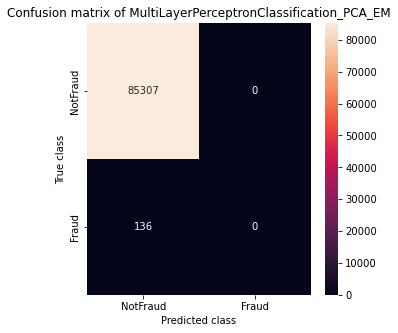

In [ ]:
y_pred_mlp_pca_em = mlp_predict_pca_em
evaluation_metrics(y_GMM_test,y_pred_mlp_pca_em,"MultiLayerPerceptronClassification")
plot_confusion_matrix(y_GMM_test,y_pred_mlp_pca_em,"MultiLayerPerceptronClassification_PCA_EM","creditcardfraud")

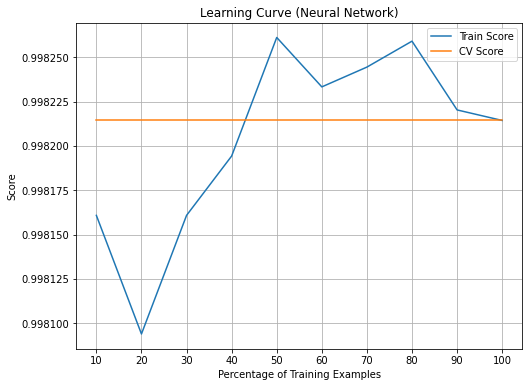

In [ ]:
# Learning Curve
classifier_neural_network_learning_pca_em = mlp_pca_em
_, train_scores, test_scores = learning_curve(classifier_neural_network_learning_pca_em, X_GMM_train, 
                                              y_GMM_train, train_sizes=np.linspace(0.1,1.0,10), cv=4)

plt.figure()
plt.plot(np.linspace(0.1,1.0,10)*100, np.mean(train_scores, axis=1), label='Train Score')
plt.plot(np.linspace(0.1,1.0,10)*100, np.mean(test_scores, axis=1), label='CV Score')
plt.legend()
plt.title("Learning Curve (Neural Network)")
plt.xlabel("Percentage of Training Examples")
plt.ylabel("Score")
plt.xticks(np.linspace(0.1,1.0,10)*100)
plt.grid()
plt.savefig('./images/cc_neural_network_learning_curve_pca_em.png')
plt.show()